In [1]:
!pip install kaggle

In [2]:
from google.colab import files

!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

# Download the Dataset
!kaggle datasets download -d vipoooool/new-plant-diseases-dataset

# Unzip the Dataset
import zipfile
import os

# Create a directory to unzip the dataset
os.makedirs('new-plant-diseases-dataset', exist_ok=True)

# Unzip the dataset
with zipfile.ZipFile('new-plant-diseases-dataset.zip', 'r') as zip_ref:
    zip_ref.extractall('new-plant-diseases-dataset')

print('Dataset downloaded and extracted successfully.')

cp: cannot stat 'kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory
Dataset URL: https://www.kaggle.com/datasets/vipoooool/new-plant-diseases-dataset
License(s): copyright-authors
100% 2.69G/2.70G [00:25<00:00, 200MB/s]
100% 2.70G/2.70G [00:25<00:00, 113MB/s]
Dataset downloaded and extracted successfully.


In [3]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, random_split
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from PIL import Image
import torch.nn.functional as fn
import matplotlib.pyplot as plt
import seaborn as sns
import os

In [4]:
dataset = "/content/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)"
train_ds = "/content/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train"
valid_ds = "/content/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid"
test_ds = "/content/new-plant-diseases-dataset/test"

In [5]:
Diseases_classes = os.listdir(train_ds)

In [6]:
print(Diseases_classes)
print("\nTotal number of classes are: ", len(Diseases_classes))

['Pepper,_bell___healthy', 'Apple___Cedar_apple_rust', 'Corn_(maize)___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Blueberry___healthy', 'Corn_(maize)___Northern_Leaf_Blight', 'Pepper,_bell___Bacterial_spot', 'Tomato___Tomato_mosaic_virus', 'Grape___healthy', 'Apple___Apple_scab', 'Soybean___healthy', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___healthy', 'Grape___Black_rot', 'Corn_(maize)___Common_rust_', 'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Target_Spot', 'Tomato___Late_blight', 'Peach___healthy', 'Grape___Esca_(Black_Measles)', 'Squash___Powdery_mildew', 'Peach___Bacterial_spot', 'Apple___healthy', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Potato___healthy', 'Potato___Early_blight', 'Tomato___Leaf_Mold', 'Raspberry___healthy', 'Tomato___Septoria_leaf_spot', 'Orange___Haunglongbing_(Citrus_greening)', 'Tomato___Bacterial_spot', 'Cherry_(including_sour)___healthy', 'Tomato___Early_blight', 

The Number of Images in Pepper,_bell___healthy: 1988
 The Number of Images in Apple___Cedar_apple_rust: 1760
 The Number of Images in Corn_(maize)___healthy: 1859
 The Number of Images in Cherry_(including_sour)___Powdery_mildew: 1683
 The Number of Images in Blueberry___healthy: 1816
 The Number of Images in Corn_(maize)___Northern_Leaf_Blight: 1908
 The Number of Images in Pepper,_bell___Bacterial_spot: 1913
 The Number of Images in Tomato___Tomato_mosaic_virus: 1790
 The Number of Images in Grape___healthy: 1692
 The Number of Images in Apple___Apple_scab: 2016
 The Number of Images in Soybean___healthy: 2022
 The Number of Images in Tomato___Tomato_Yellow_Leaf_Curl_Virus: 1961
 The Number of Images in Tomato___healthy: 1926
 The Number of Images in Grape___Black_rot: 1888
 The Number of Images in Corn_(maize)___Common_rust_: 1907
 The Number of Images in Strawberry___Leaf_scorch: 1774
 The Number of Images in Strawberry___healthy: 1824
 The Number of Images in Tomato___Target_Spot:

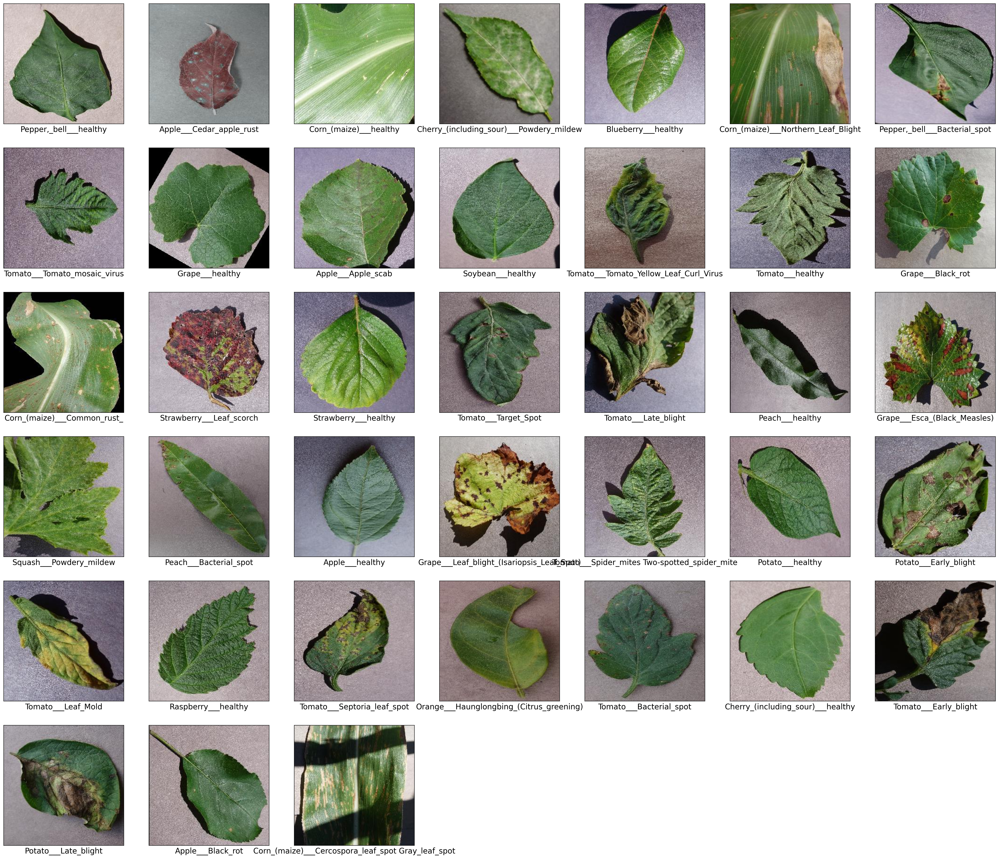

In [7]:
plt.figure(figsize=(35,35), dpi=200)
cnt = 0
class_names = []
tot_images = 0

for i in Diseases_classes:
    cnt += 1
    class_names.append(i)
    plt.subplot(7,7,cnt)

    image_path = os.listdir(train_ds + "/" + i)
    print("The Number of Images in " +i+ ":", len(image_path), end= "\n ")
    tot_images += len(image_path)

    img_show = plt.imread(train_ds + "/" + i + "/" + image_path[0])

    plt.imshow(img_show)
    plt.xlabel(i,fontsize=15)
    plt.xticks([])
    plt.yticks([])

print("\nTotal Number of Images in Directory: ", tot_images)

In [8]:
train_ds = ImageFolder(train_ds, transform=transforms.ToTensor())
valid_ds = ImageFolder(valid_ds, transform=transforms.ToTensor())
test_ds = ImageFolder(test_ds, transform=transforms.ToTensor())

In [9]:
len(train_ds)

70295

In [10]:
len(valid_ds)

17572

In [11]:
len(test_ds)

33

In [12]:
# test_ds is too small so splitting valid_ds to (valid_ds and test_ds)
# splitting 50-50
valid_size = len(valid_ds)
new_valid_size = valid_size // 2
test_size = valid_size - new_valid_size
print("Valid Size: ", valid_size)
print("New Valid Size: ", new_valid_size)
print("Test Size: ", test_size)
valid_ds, test_ds = random_split(valid_ds, [new_valid_size, test_size])

Valid Size:  17572
New Valid Size:  8786
Test Size:  8786


In [13]:
print(len(train_ds))
print(len(valid_ds))
print(len(test_ds))

70295
8786
8786


In [14]:
train_ds[0]

(tensor([[[0.6549, 0.6510, 0.6471,  ..., 0.7255, 0.7176, 0.7098],
          [0.6667, 0.6627, 0.6588,  ..., 0.7294, 0.7216, 0.7176],
          [0.6667, 0.6627, 0.6588,  ..., 0.7373, 0.7294, 0.7255],
          ...,
          [0.3922, 0.4000, 0.4078,  ..., 0.4941, 0.4941, 0.4941],
          [0.3961, 0.4000, 0.4039,  ..., 0.4784, 0.4824, 0.4824],
          [0.4078, 0.4039, 0.4000,  ..., 0.4745, 0.4784, 0.4824]],
 
         [[0.6392, 0.6353, 0.6314,  ..., 0.7137, 0.7059, 0.6980],
          [0.6510, 0.6471, 0.6431,  ..., 0.7176, 0.7098, 0.7059],
          [0.6510, 0.6471, 0.6431,  ..., 0.7255, 0.7176, 0.7137],
          ...,
          [0.3529, 0.3608, 0.3686,  ..., 0.4314, 0.4314, 0.4314],
          [0.3569, 0.3608, 0.3647,  ..., 0.4157, 0.4196, 0.4196],
          [0.3686, 0.3647, 0.3608,  ..., 0.4118, 0.4157, 0.4196]],
 
         [[0.7686, 0.7647, 0.7608,  ..., 0.8275, 0.8196, 0.8118],
          [0.7804, 0.7765, 0.7725,  ..., 0.8314, 0.8235, 0.8196],
          [0.7804, 0.7765, 0.7725,  ...,

In [15]:
valid_ds[0]

(tensor([[[0.5333, 0.5020, 0.5059,  ..., 0.5804, 0.5804, 0.5804],
          [0.5490, 0.5176, 0.5137,  ..., 0.5569, 0.5686, 0.5804],
          [0.5490, 0.5176, 0.5059,  ..., 0.5490, 0.5647, 0.5882],
          ...,
          [0.3647, 0.3608, 0.3922,  ..., 0.3294, 0.3255, 0.3176],
          [0.3569, 0.3333, 0.3882,  ..., 0.3098, 0.3176, 0.3333],
          [0.3569, 0.3216, 0.3961,  ..., 0.3098, 0.3059, 0.3176]],
 
         [[0.5412, 0.5098, 0.5137,  ..., 0.5804, 0.5804, 0.5804],
          [0.5569, 0.5255, 0.5216,  ..., 0.5569, 0.5686, 0.5804],
          [0.5569, 0.5255, 0.5137,  ..., 0.5490, 0.5647, 0.5882],
          ...,
          [0.3490, 0.3451, 0.3765,  ..., 0.3216, 0.3176, 0.3098],
          [0.3412, 0.3176, 0.3725,  ..., 0.3020, 0.3098, 0.3255],
          [0.3412, 0.3059, 0.3804,  ..., 0.3020, 0.2980, 0.3098]],
 
         [[0.5373, 0.5059, 0.5098,  ..., 0.5882, 0.5882, 0.5882],
          [0.5529, 0.5216, 0.5176,  ..., 0.5647, 0.5765, 0.5882],
          [0.5529, 0.5216, 0.5098,  ...,

In [16]:
test_ds[0]

(tensor([[[0.5176, 0.5216, 0.5216,  ..., 0.3922, 0.3843, 0.3765],
          [0.5176, 0.5216, 0.5216,  ..., 0.3922, 0.3961, 0.4000],
          [0.5176, 0.5216, 0.5216,  ..., 0.3765, 0.3961, 0.4078],
          ...,
          [0.6431, 0.6353, 0.6275,  ..., 0.4667, 0.4706, 0.4745],
          [0.6471, 0.6353, 0.6235,  ..., 0.4824, 0.4706, 0.4667],
          [0.6510, 0.6353, 0.6235,  ..., 0.4863, 0.4667, 0.4549]],
 
         [[0.5490, 0.5529, 0.5529,  ..., 0.4157, 0.4078, 0.4000],
          [0.5490, 0.5529, 0.5529,  ..., 0.4157, 0.4196, 0.4235],
          [0.5490, 0.5529, 0.5529,  ..., 0.4000, 0.4196, 0.4314],
          ...,
          [0.6667, 0.6588, 0.6510,  ..., 0.4824, 0.4863, 0.4902],
          [0.6706, 0.6588, 0.6471,  ..., 0.4980, 0.4863, 0.4824],
          [0.6745, 0.6588, 0.6471,  ..., 0.5020, 0.4824, 0.4706]],
 
         [[0.5569, 0.5608, 0.5608,  ..., 0.4157, 0.4078, 0.4000],
          [0.5569, 0.5608, 0.5608,  ..., 0.4157, 0.4196, 0.4235],
          [0.5569, 0.5608, 0.5608,  ...,

In [17]:
img ,Label = train_ds[0]
print(img.shape)
print(Label)

torch.Size([3, 256, 256])
0


In [18]:
img_height=256
img_width=256
batch_size=32
channels=3

In [19]:
train_dataloader = DataLoader(train_ds, batch_size, shuffle=True, num_workers=2, pin_memory=True)
valid_dataloader = DataLoader(valid_ds, batch_size,shuffle=True, num_workers=2, pin_memory=True)
test_dataloader = DataLoader(test_ds, batch_size, shuffle=True,num_workers=2, pin_memory=True)

In [20]:
# for running model in GPU
def get_default_device():
    if torch.cuda.is_available():
        return torch.device("cuda")
    else:
        return torch.device("cpu")

In [21]:
def to_device(data, device):
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

In [22]:
class DeviceDataLoader():
    def __init__(self, dataloader, device):
        self.dataloader = dataloader
        self.device = device

    def __iter__(self):
        for b in self.dataloader:
            yield to_device(b, self.device)

    def __len__(self):
        return len(self.dataloader)

In [23]:
device = get_default_device()
device

device(type='cuda')

In [24]:
train_dataloader = DeviceDataLoader(train_dataloader, device)
valid_dataloader = DeviceDataLoader(valid_dataloader, device)
test_dataloader = DeviceDataLoader(test_dataloader, device)

In [25]:
def accuracy(outputs, labels):
    _, preds = torch.max(outputs, dim=1)
    return torch.tensor(torch.sum(preds == labels).item() / len(preds))

In [26]:
# defining own basemodel for making our own custom model
class BaseModel(nn.Module):

    def training_step(self, batch):
        images, labels = batch
        out = self(images)                   # Generate predictions
        loss = fn.cross_entropy(out, labels) # Calculate loss
        return loss

    def validation_step(self, batch):
        images, labels = batch
        out = self(images)                    # Generate predictions
        loss = fn.cross_entropy(out, labels)   # Calculate loss
        acc = accuracy(out, labels)           # Calculate accuracy
        return {'val_loss': loss.detach(), 'val_acc': acc}

    def validation_epoch_end(self, outputs):
        batch_losses = [x['val_loss'] for x in outputs]
        epoch_loss = torch.stack(batch_losses).mean()   # Combine losses
        batch_accs = [x['val_acc'] for x in outputs]
        epoch_acc = torch.stack(batch_accs).mean()      # Combine accuracies
        return {'val_loss': epoch_loss.item(), 'val_acc': epoch_acc.item()}

    def epoch_end(self, epoch, result):
        print("Epoch [{}], train_loss: {:.4f}, val_loss: {:.4f}, val_acc: {:.4f}".format(
            epoch, result['train_loss'], result['val_loss'], result['val_acc']))

In [27]:
# defining convolutional block for ease to use in our CNN model
def ConvBlock(in_channels, out_channels, pool=False):
    layers = [nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
             nn.BatchNorm2d(out_channels),
             nn.ReLU(inplace=True)]
    if pool:
        layers.append(nn.MaxPool2d(4))
    return nn.Sequential(*layers)

In [28]:
# also using resnet model for more accuracy
class CNN_Model(BaseModel):
    def __init__(self, in_channels, num_diseases):
        super().__init__()

        self.conv1 = ConvBlock(in_channels, 64)
        self.conv2 = ConvBlock(64, 128, pool=True)
        self.res1 = nn.Sequential(ConvBlock(128, 128), ConvBlock(128, 128))

        self.conv3 = ConvBlock(128, 256, pool=True)
        self.conv4 = ConvBlock(256, 512, pool=True)

        self.res2 = nn.Sequential(ConvBlock(512, 512), ConvBlock(512, 512))
        self.classifier = nn.Sequential(nn.MaxPool2d(4),
                                        nn.Flatten(),
                                        nn.Linear(512, num_diseases))

    def forward(self, x): # x is the loaded batch
        out = self.conv1(x)
        out = self.conv2(out)
        out = self.res1(out) + out
        out = self.conv3(out)
        out = self.conv4(out)
        out = self.res2(out) + out
        out = self.classifier(out)
        return out

In [29]:
model = to_device(CNN_Model(3, len(train_ds.classes)), device)
model

CNN_Model(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (res1): Sequential(
    (0): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=

In [30]:
@torch.no_grad()
def evaluate(model, val_loader):
    model.eval()
    outputs = [model.validation_step(batch) for batch in val_loader]
    return model.validation_epoch_end(outputs)

In [31]:
def learning_rate(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']

In [32]:
# using one cycle learning rate policy
# Sets the learning rate of each parameter group according to the 1cycle learning rate policy.
# In this policy learning rate goes from an initial learning rate to some maximum learning rate and
# then from that maximum learning rate to some minimum learning rate much lower than the initial learning rate.

def fit_OneCycle(epochs, max_lr, model, train_dataloader, valid_dataloader, weight_decay=0, grad_clip=None, opt_func=torch.optim.SGD):
    torch.cuda.empty_cache()
    history = []

    optimizer = opt_func(model.parameters(), max_lr, weight_decay=weight_decay)
    scheduled = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr,epochs=epochs, steps_per_epoch=len(train_dataloader))

    for epoch in range(epochs):
        model.train()
        learning_rates = []
        train_losses = []
        for batch in train_dataloader:
            loss = model.training_step(batch)
            train_losses.append(loss)
            loss.backward()

            # gradient clipping
            if grad_clip:
                nn.utils.clip_grad_value_(model.parameters(), grad_clip)

            optimizer.step()
            optimizer.zero_grad()
            # recording and updating learning rates
            learning_rates.append(learning_rate(optimizer))
            scheduled.step()

        result = evaluate(model, valid_dataloader)
        result['train_loss'] = torch.stack(train_losses).mean().item()
        result['lrs'] = learning_rates
        model.epoch_end(epoch, result)
        history.append(result)

    return history

In [33]:
%%time
history = [evaluate(model, valid_dataloader)]
history

CPU times: user 29.5 s, sys: 3.14 s, total: 32.7 s
Wall time: 35.8 s


[{'val_loss': 3.6382715702056885, 'val_acc': 0.027108585461974144}]

In [34]:
num_epoch = 7
max_lr = 0.01
grad_clip = 0.15
weight_decay = 1e-4
optims = torch.optim.Adam

In [37]:
%%time
history += fit_OneCycle(num_epoch, max_lr, model, train_dataloader, valid_dataloader, grad_clip=grad_clip, weight_decay=weight_decay, opt_func=optims)
history

Epoch [0], train_loss: 0.4367, val_loss: 0.8737, val_acc: 0.7648
Epoch [1], train_loss: 0.3374, val_loss: 0.7303, val_acc: 0.7778
Epoch [2], train_loss: 0.2729, val_loss: 0.2447, val_acc: 0.9209
Epoch [3], train_loss: 0.1800, val_loss: 0.1298, val_acc: 0.9585
Epoch [4], train_loss: 0.1104, val_loss: 0.1057, val_acc: 0.9645
Epoch [5], train_loss: 0.0466, val_loss: 0.0384, val_acc: 0.9880
Epoch [6], train_loss: 0.0156, val_loss: 0.0221, val_acc: 0.9937
CPU times: user 46min 17s, sys: 57min 33s, total: 1h 43min 51s
Wall time: 1h 46min 29s


[{'val_loss': 3.6382715702056885, 'val_acc': 0.027108585461974144},
 {'val_loss': 0.8737261295318604,
  'val_acc': 0.7647853493690491,
  'train_loss': 0.436689555644989,
  'lrs': [0.0003999999999999993,
   0.00040000111327011256,
   0.00040000445307993883,
   0.00040001001942792554,
   0.0004000178123114914,
   0.00040002783172702304,
   0.0004000400776698731,
   0.0004000545501343586,
   0.00040007124911376965,
   0.00040009017460035726,
   0.00040011132658534544,
   0.00040013470505891914,
   0.0004001603100102346,
   0.0004001881414274176,
   0.0004002181992975567,
   0.0004002504836067098,
   0.00040028499433989936,
   0.00040032173148111735,
   0.0004003606950133236,
   0.0004004018849184457,
   0.0004004453011773757,
   0.0004004909437699735,
   0.00040053881267507023,
   0.00040058890787045796,
   0.00040064122933290355,
   0.0004006957770381313,
   0.00040075255096084367,
   0.0004008115510747024,
   0.0004008727773523405,
   0.0004009362297653588,
   0.0004010019082843208,
   

In [59]:
train_losses = []
val_losses = []
val_accs = []

for i in history:
    val_accs.append(i['val_acc'])
    val_losses.append(i['val_loss'])
    train_losses.append(i.get('train_loss'))

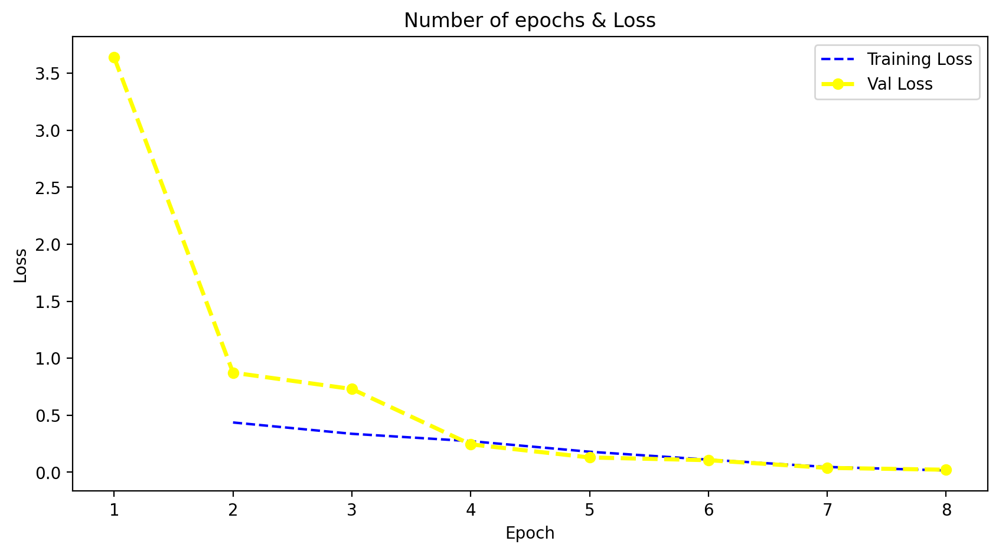

In [60]:
epoch_count = range(1,9)
plt.figure(figsize=(10,5), dpi=200)
plt.plot(epoch_count, train_losses, 'r--', color= 'blue')
plt.plot(epoch_count, val_losses, '--bo',color= 'yellow', linewidth = '2.5', label='line with marker')
plt.legend(['Training Loss', 'Val Loss'])
plt.title('Number of epochs & Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(np.arange(1,9,1))
plt.show();

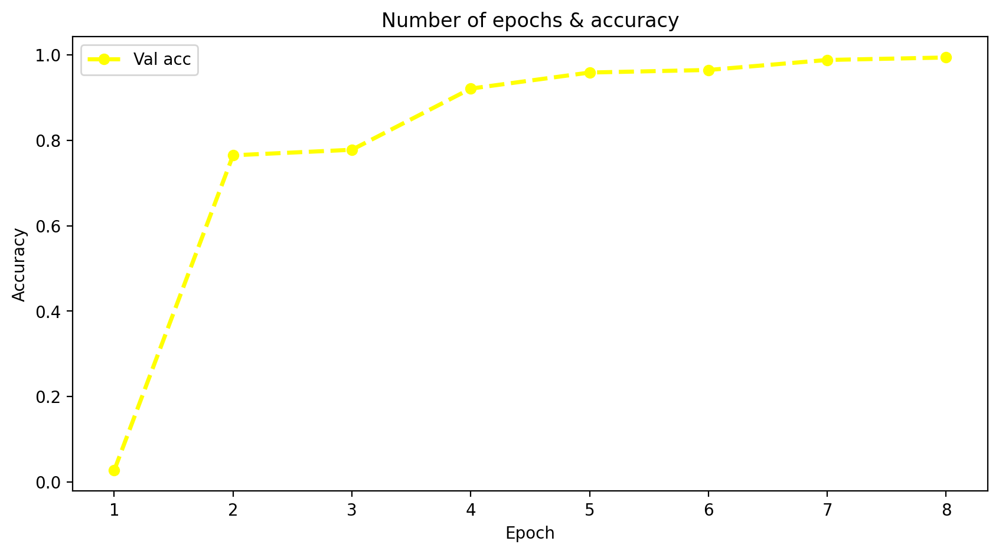

In [61]:
epoch_count = range(1,9)
plt.figure(figsize=(10,5), dpi=200)
plt.plot(epoch_count, val_accs, '--bo',color= 'yellow', linewidth = '2.5', label='line with marker')
plt.legend(['Val acc'])
plt.title('Number of epochs & accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.xticks(np.arange(1,9,1))
plt.show();

In [67]:
scores=[evaluate(model,test_dataloader)]
scores

[{'val_loss': 0.020098403096199036, 'val_acc': 0.9943181872367859}]

In [68]:
def prediction(img,model):
    x = to_device(img.unsqueeze(0), device)
    y = model(x)
    _, predict = torch.max(y, dim=1)
    return predict[0].item()

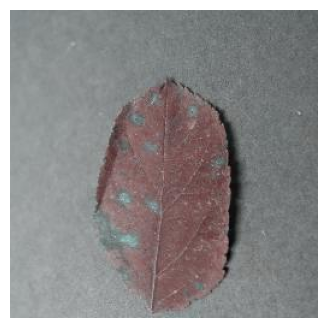

Actual:  Corn_(maize)___healthy
Predicted:  Corn_(maize)___healthy

--------------------------------------------------



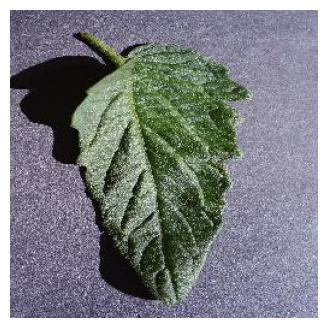

Actual:  Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot
Predicted:  Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot

--------------------------------------------------



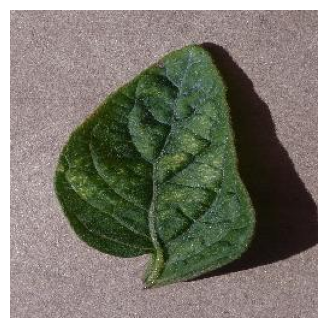

Actual:  Cherry_(including_sour)___healthy
Predicted:  Cherry_(including_sour)___healthy

--------------------------------------------------



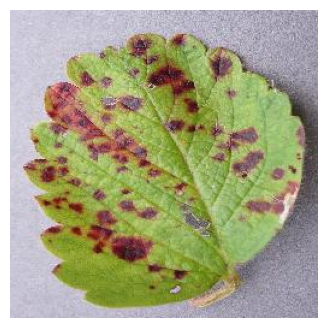

Actual:  Potato___healthy
Predicted:  Potato___healthy

--------------------------------------------------



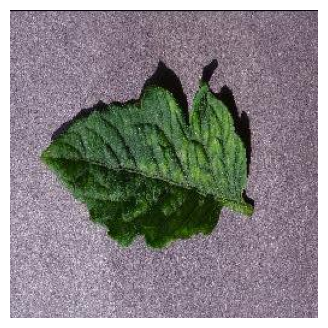

Actual:  Apple___Black_rot
Predicted:  Apple___Black_rot

--------------------------------------------------



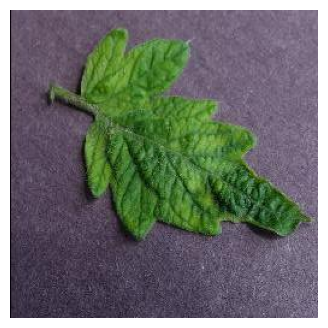

Actual:  Apple___Black_rot
Predicted:  Apple___Black_rot

--------------------------------------------------



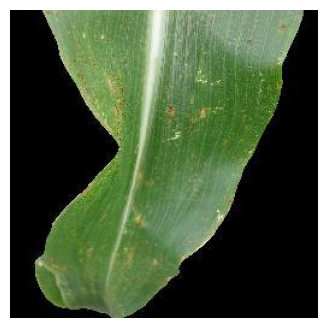

Actual:  Grape___healthy
Predicted:  Grape___healthy

--------------------------------------------------



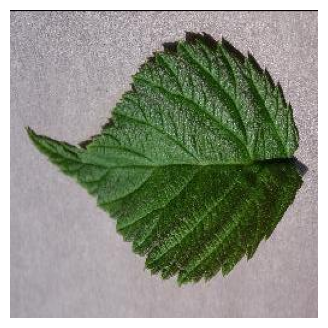

Actual:  Apple___healthy
Predicted:  Apple___healthy

--------------------------------------------------



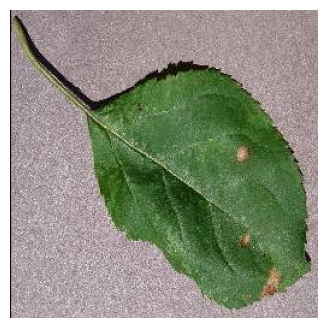

Actual:  Apple___Cedar_apple_rust
Predicted:  Apple___Cedar_apple_rust

--------------------------------------------------



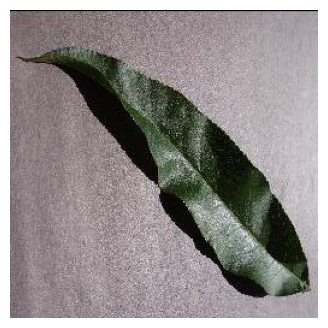

Actual:  Tomato___Target_Spot
Predicted:  Tomato___Target_Spot

--------------------------------------------------



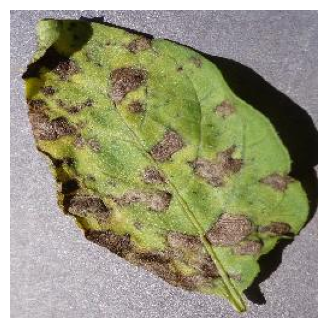

Actual:  Grape___Esca_(Black_Measles)
Predicted:  Grape___Esca_(Black_Measles)

--------------------------------------------------



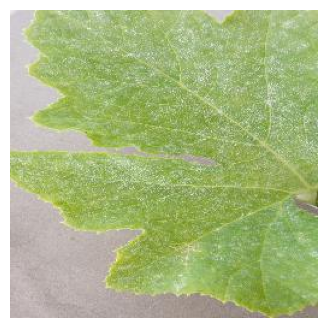

Actual:  Tomato___Spider_mites Two-spotted_spider_mite
Predicted:  Tomato___Spider_mites Two-spotted_spider_mite

--------------------------------------------------



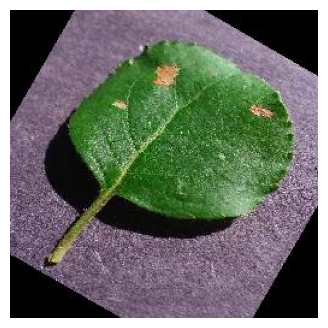

Actual:  Apple___Cedar_apple_rust
Predicted:  Apple___Cedar_apple_rust

--------------------------------------------------



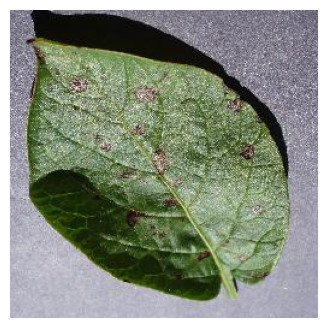

Actual:  Grape___Esca_(Black_Measles)
Predicted:  Grape___Esca_(Black_Measles)

--------------------------------------------------



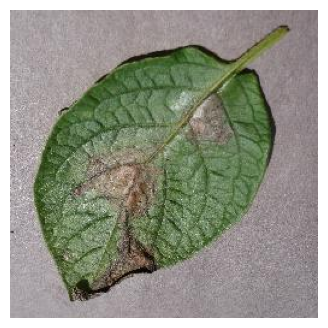

Actual:  Squash___Powdery_mildew
Predicted:  Squash___Powdery_mildew

--------------------------------------------------



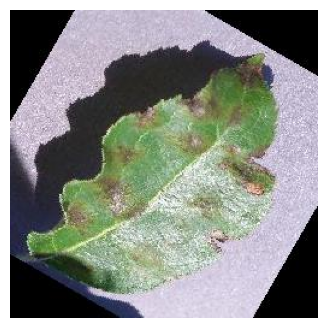

Actual:  Pepper,_bell___healthy
Predicted:  Pepper,_bell___healthy

--------------------------------------------------



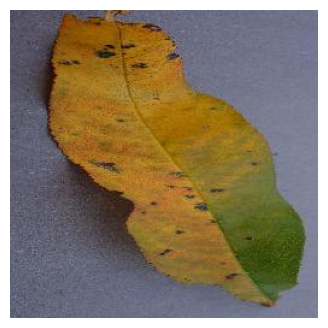

Actual:  Strawberry___healthy
Predicted:  Strawberry___healthy

--------------------------------------------------



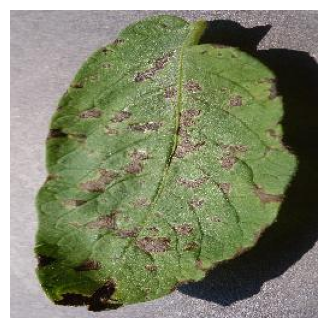

Actual:  Grape___Esca_(Black_Measles)
Predicted:  Grape___Esca_(Black_Measles)

--------------------------------------------------



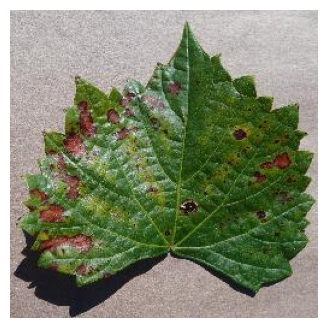

Actual:  Tomato___healthy
Predicted:  Tomato___healthy

--------------------------------------------------



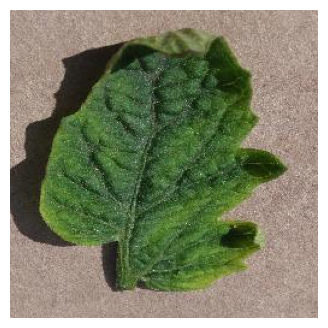

Actual:  Potato___Late_blight
Predicted:  Potato___Late_blight

--------------------------------------------------



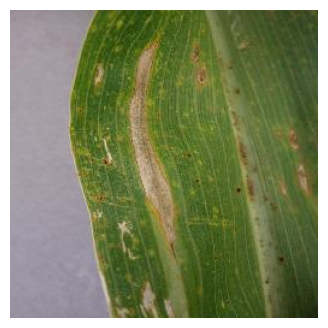

Actual:  Apple___Apple_scab
Predicted:  Apple___Apple_scab

--------------------------------------------------



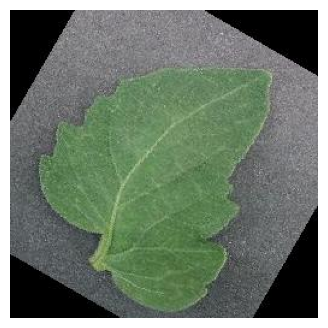

Actual:  Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot
Predicted:  Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot

--------------------------------------------------



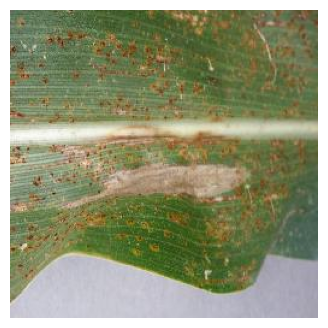

Actual:  Apple___Apple_scab
Predicted:  Apple___Apple_scab

--------------------------------------------------



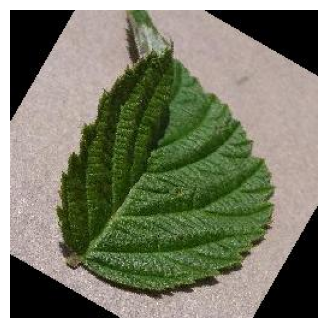

Actual:  Apple___healthy
Predicted:  Apple___healthy

--------------------------------------------------



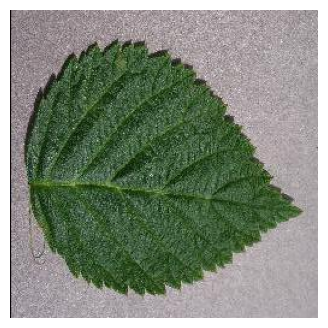

Actual:  Apple___healthy
Predicted:  Apple___healthy

--------------------------------------------------



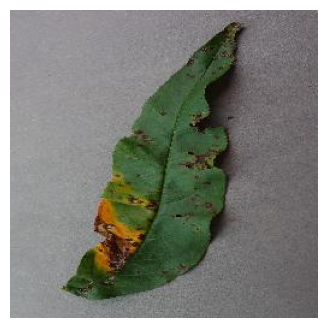

Actual:  Strawberry___healthy
Predicted:  Strawberry___healthy

--------------------------------------------------



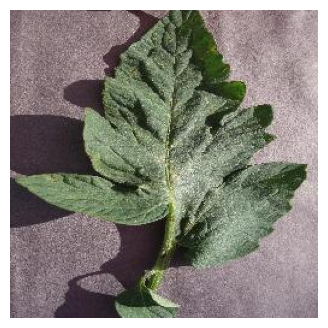

Actual:  Tomato___Early_blight
Predicted:  Tomato___Early_blight

--------------------------------------------------



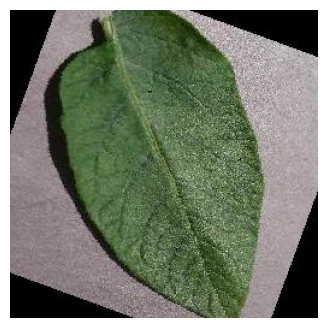

Actual:  Peach___Bacterial_spot
Predicted:  Peach___Bacterial_spot

--------------------------------------------------



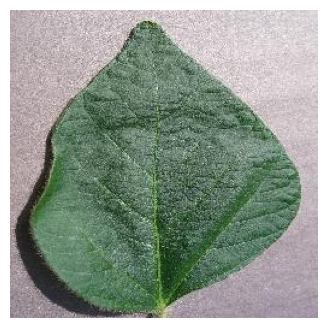

Actual:  Grape___Leaf_blight_(Isariopsis_Leaf_Spot)
Predicted:  Grape___Leaf_blight_(Isariopsis_Leaf_Spot)

--------------------------------------------------



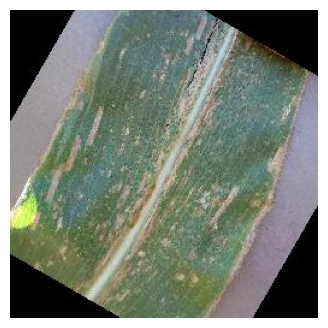

Actual:  Tomato___Tomato_mosaic_virus
Predicted:  Tomato___Tomato_mosaic_virus

--------------------------------------------------



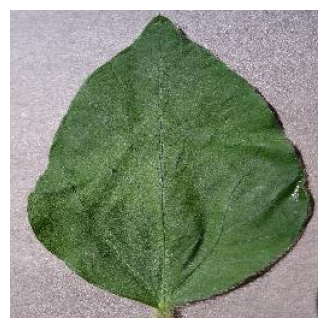

Actual:  Grape___Leaf_blight_(Isariopsis_Leaf_Spot)
Predicted:  Grape___Leaf_blight_(Isariopsis_Leaf_Spot)

--------------------------------------------------



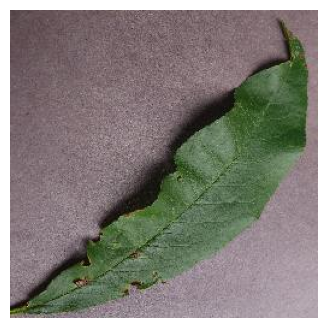

Actual:  Strawberry___healthy
Predicted:  Strawberry___healthy

--------------------------------------------------



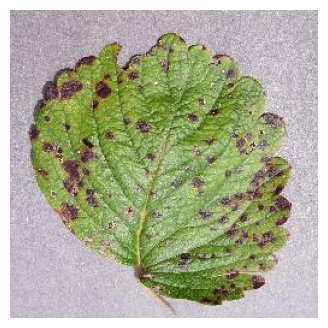

Actual:  Potato___healthy
Predicted:  Potato___healthy

--------------------------------------------------



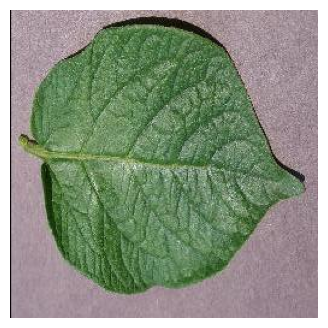

Actual:  Peach___Bacterial_spot
Predicted:  Peach___Bacterial_spot

--------------------------------------------------



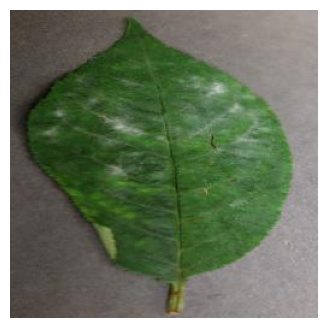

Actual:  Corn_(maize)___Northern_Leaf_Blight
Predicted:  Corn_(maize)___Northern_Leaf_Blight

--------------------------------------------------



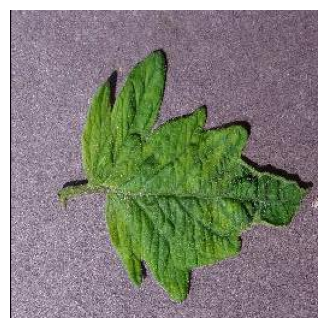

Actual:  Apple___Black_rot
Predicted:  Apple___Black_rot

--------------------------------------------------



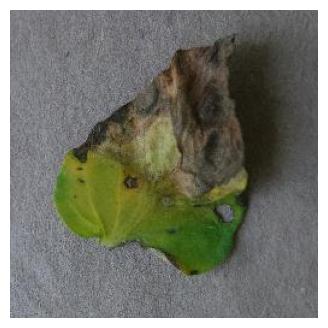

Actual:  Raspberry___healthy
Predicted:  Tomato___Septoria_leaf_spot

--------------------------------------------------



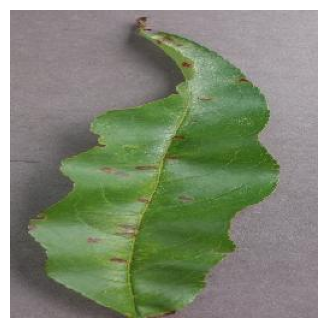

Actual:  Strawberry___healthy
Predicted:  Strawberry___healthy

--------------------------------------------------



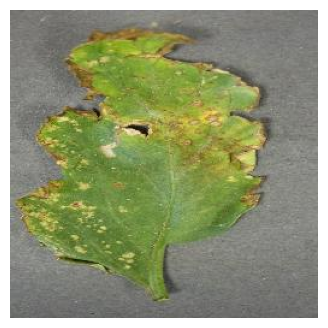

Actual:  Tomato___Leaf_Mold
Predicted:  Tomato___Leaf_Mold

--------------------------------------------------



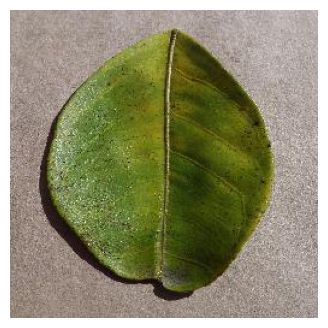

Actual:  Strawberry___Leaf_scorch
Predicted:  Strawberry___Leaf_scorch

--------------------------------------------------



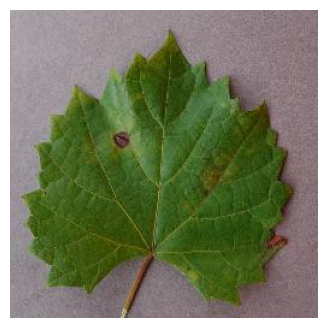

Actual:  Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predicted:  Tomato___Tomato_Yellow_Leaf_Curl_Virus

--------------------------------------------------



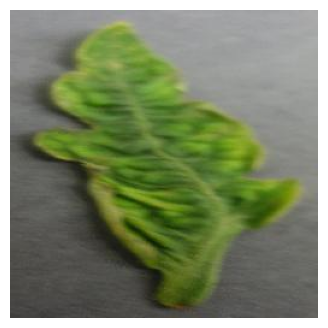

Actual:  Potato___Late_blight
Predicted:  Potato___Late_blight

--------------------------------------------------



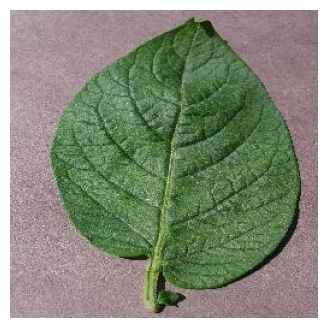

Actual:  Peach___Bacterial_spot
Predicted:  Peach___Bacterial_spot

--------------------------------------------------



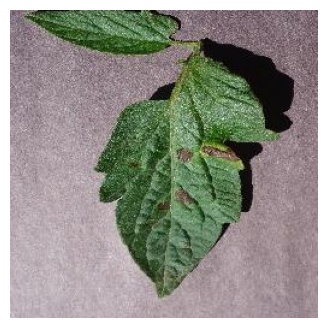

Actual:  Raspberry___healthy
Predicted:  Raspberry___healthy

--------------------------------------------------



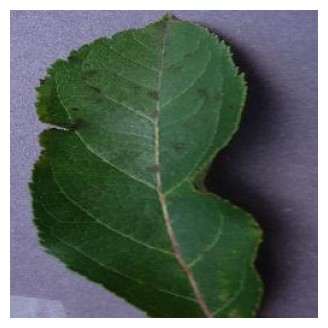

Actual:  Pepper,_bell___healthy
Predicted:  Pepper,_bell___healthy

--------------------------------------------------



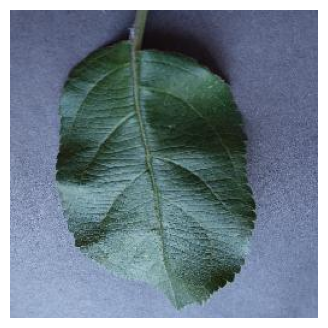

Actual:  Cherry_(including_sour)___Powdery_mildew
Predicted:  Cherry_(including_sour)___Powdery_mildew

--------------------------------------------------



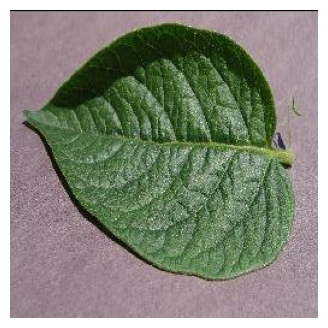

Actual:  Peach___Bacterial_spot
Predicted:  Peach___Bacterial_spot

--------------------------------------------------



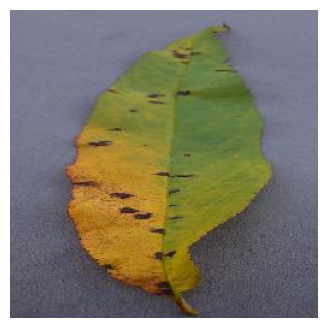

Actual:  Strawberry___healthy
Predicted:  Strawberry___healthy

--------------------------------------------------



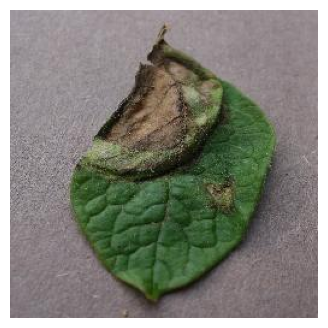

Actual:  Squash___Powdery_mildew
Predicted:  Squash___Powdery_mildew

--------------------------------------------------



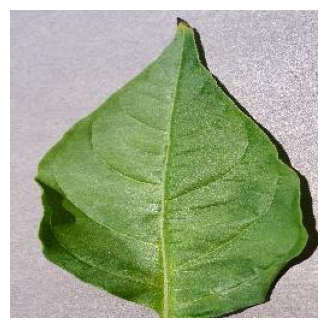

Actual:  Peach___healthy
Predicted:  Peach___healthy

--------------------------------------------------



In [72]:
# predicting first 50 images from test_ds
for i in range (50):
   image,label = test_ds[i]
   plt.figure(figsize=(4, 4))
   plt.imshow(image.permute(1,2,0))
   plt.axis('off')
   plt.show()
   print('Actual: ',Diseases_classes[label])
   pred = prediction(image,model)
   print('Predicted: ',Diseases_classes[pred])
   print('\n--------------------------------------------------\n')

In [70]:
# Save entire model
torch.save(model, "Plant_disease_model.pth")

In [71]:
# Save state dictionary
torch.save(model.state_dict(), "Plant_disease_detection_model.pth")